# Gradient Descent Algorithms & Visualization

__IMPORTANT NOTE:__ the variables `x` and `y` are the parameters that we're optimizing!

## Simple Gradient Descent

This is nice and simple, but it doesn't quite converge. Let's write and improved gradient descent with greater precision, then run it against the Rosenbrock Function, which is a non-convex function designed for testing optimization algorithms.

In [2]:
# symbolic math with python
from sympy import *

# tell SymPy to start printing output with LaTeX
init_printing() 

# jit compiling
from numba import jit

# numpy
import numpy as np

x, y = symbols('x y')
f = x**3 + y**3
f_ = f.diff(x)+f.diff(y)
display(f)

display(f_)
init_printing(pretty_print=False)

F = lambdify((x,y), f)
F_ = lambdify((x,y), f_)

In [3]:
thisx = 6
thisy = 6
gx, gy = 0.01, 0.01 # step size scaling AKA learning rate
precision = 0.00001
prev_xstep, prev_ystep = 5, 5
iters = 0 # iteration counter
steps = [[thisx,thisy]]

for i in range(200):
    if prev_xstep > precision or prev_ystep > precision:
        prevx, prevy = thisx, thisy
        thisx -= gx*F_(prevx,prevy) 
        thisy -= gy*F_(prevx,prevy) 
        prev_xstep, prev_ystep = abs(thisx-prevx), abs(thisy-prevy)
        iters+=1
        steps.append([thisx,thisy])
        
steps = np.asarray(steps)        

print("Steps performed: ", iters)
print(thisx, thisy)
print(prevx, prevy)
print(prev_xstep, prev_ystep)

Steps performed:  200
0.08038188767406633 0.08038188767406633
0.08077334769594695 0.08077334769594695
0.00039146002188061857 0.00039146002188061857


In [4]:
# Poltly plotting API
import plotly.offline as py
import plotly.graph_objs as go

# tell Plotly to display in our notebook
from plotly.offline import init_notebook_mode
init_notebook_mode()

# generate discrete grid of points on x and y axes
x = np.arange(-6, 6, 0.1)
y = np.arange(-6, 6, 0.1)

# mesh the axes (create x-y plane)
x, y = np.meshgrid(x, y)

# generate the z-coordinates for each discrete point in the xy plane
# for our surfaces
z = F_(x, y)      # surface 1: convex polynomial surface
z_ = F_(x, y)    # surface 2: derivative of surface 1, it's a plane

# make sure the graph is proportional when it renders
layout = go.Layout(
    scene=dict(
        aspectratio=dict(x=1, y=1, z=1)
    )
)

# define the plotly object for our surfaces
surface = go.Surface(x=x, y=y, z=z, colorscale='Viridis', opacity=0.8)
#surface_ = go.Surface(x=x, y=y, z=z_, colorscale='Cividis', opacity=1)

# plot the path of the descent
a = [0,     3]
b = [0,     3]
c = [0,F_(3,3)]
points = go.Scatter3d(x=steps[:,0],y=steps[:,1],z=F_(steps[:,0], steps[:,1]))

#plot it!
data = [surface, points]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

## Improved Gradient Descent

This one works well and has increased resiliancy with non-convex functions, but it is still dependent on its initial position and overly-dependent on initial hyperparameters. Take, for example, these several illustrations of its performance with the Rosenbrock function.


Furthermore, this significantly increases the computational expense of the algorithm.

In [244]:
# symbolic math with python
from sympy import *

# tell SymPy to start printing output with LaTeX
init_printing() 

# jit compiling
from numba import jit

# numpy
import numpy as np

x, y = symbols('x y')
f_ = (1-x)**2 + 100*(y - x**2)**2

display(f_)
init_printing(pretty_print=False)

F = lambdify((x,y), f)
F_ = lambdify((x,y), f_)

In [260]:
def my_grad_descent(# function representing the surface we're descending
                            F_,
                    # current (starting) x-position:
                            curx = 1,    
                    # current (starting) y-position:
                            cury = 1,   
                    # delta-z, change in z-position, z = f(x,y):
                            dz = 1,   
                    # arclength resolution: (2pi radians / arcres):
                            arcres = 8,
                    # factor to multiply arclength resolution for fine searching:
                            arcr_boost = 4,
                    # radius of search func / linear resolution:
                            linres = 2, 
                    # minimum linear search length:
                            min_linres = 0.0001, 
                    # scaling factor for learning
                    ## resolution scaling:
                            rate = 0.6,
                    # maximum number of iterations:
                            maxiter = 200, ):
    
    curz = F_(curx, cury) # starting z-position
    steps = [[curx,cury,curz]] # track the steps taken by the algorithm

    # DEFINE SEARCH FUNCTION
    def find_best_direction(f, curx, cury, linres, arcres): # f is a math func that takes two inputs (x, y)
        
        def search_radius(curx, cury, linres, arcres):
            arcsecs = [(2*np.pi / arcres) * i for i in range(arcres)]
            radii = np.asarray([[curx + linres*np.cos(i), 
                                 cury + linres*np.sin(i)] 
                                for i in arcsecs])
            return radii
        
        radii = search_radius(curx, cury, linres, arcres)
        zs = [f(i[0], i[1]) for i in radii] # set of z-values, such that z_n = f(x_n, y_n)

        # return [x, y, z]  for (x,y) that give greatest change in z
        xy = radii[zs.index(min(zs))]
        return np.asarray([xy[0], xy[1], min(zs)])   
    
    # DO THE CALCULATIONS
    for i in range(maxiter):
        if dz < 0:
            prevx, prevy = curx, cury
            prevz = curz

            best_dir = find_best_direction(F_, curx, cury, linres, arcres)

            curx, cury = best_dir[0], best_dir[1]
            curz = best_dir[2]

            xstep, ystep = abs(curx - prevx), abs(cury - prevy)
            delta = curz - prevz

            steps.append([curx, cury, curz])

        elif dz == 0: break

        else:
            prevx, prevy = curx, cury
            prevz = curz

            best_dirs = np.asarray([find_best_direction(F_, curx, cury, linres*rate**i, 
                                                        arcres*arcr_boost) 
                                    for i in list(range(-10, 10))])

            # sort based on z values and choose the smallest z
            best_dir = best_dirs[[np.argsort(best_dirs[:,2])], :][0][0]
            
            curx, cury = best_dir[0], best_dir[1]
            curz = best_dir[2]

            xstep, ystep = abs(curx - prevx), abs(cury - prevy)
            dz = curz - prevz

            steps.append([curx, cury, curz])

    return np.asarray(steps)

In [271]:
steps = my_grad_descent(F_ = F_, curx=3, cury=3, arcres=21, linres=0.01, rate=0.1, maxiter=355)

print(steps, "\n\n\n")

print((steps[-1], len(steps)))

[[ 3.00000000e+00  3.00000000e+00  3.60400000e+03]
 [-3.23489802e+00  1.08183148e+01  3.04482416e+01]
 [-3.24478633e+00  1.08168244e+01  2.63233335e+01]
 ...
 [-2.72285717e+00  7.42043484e+00  1.38638693e+01]
 [-2.72210987e+00  7.41046281e+00  1.38541356e+01]
 [-2.71845646e+00  7.40115407e+00  1.38393475e+01]] 



(array([-2.71845646,  7.40115407, 13.83934746]), 356)


In [1]:
# Plotly plotting API
import plotly.offline as py
import plotly.graph_objs as go

# tell Plotly to display in our notebook
from plotly.offline import init_notebook_mode
init_notebook_mode()

# generate discrete grid of points on x and y axes
x = np.arange(-3.5, 8, 0.1)
y = np.arange(-0, 12, 0.1)

# mesh the axes (create x-y plane)
x, y = np.meshgrid(x, y)

# generate the z-coordinates for each discrete point in the xy plane
# for our surfaces
z = F_(x, y)      # surface 1: convex polynomial surface
z_ = F_(x, y)    # surface 2: derivative of surface 1, it's a plane

# make sure the graph is proportional when it renders
layout = go.Layout(
    scene=dict(
        aspectratio=dict(x=1, y=1, z=1)
    )
)

# define the plotly object for our surfaces
surface = go.Surface(x=x, y=y, z=z, colorscale='Viridis', opacity=0.9)
#surface_ = go.Surface(x=x, y=y, z=z_, colorscale='Cividis', opacity=1)

# plot the path of the descent
points = go.Scatter3d(x=steps[:,0],
                      y=steps[:,1],
                      z=steps[:,2], 
                      #mode = 'lines',
                      marker = dict(size = 4,
                                    color = list(range(len(steps))),
                                    colorscale='Jet'),
                      hoverinfo='z'
                      )

# plot the starting point, for reference
points_ = go.Scatter3d(x=[steps[-1,0]], y=[steps[-1,1]], z=[steps[-1,2]], marker=dict(size=6))

#plot it!
data = [surface, points, points_]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

ModuleNotFoundError: No module named 'plotly'

In [227]:
steps = my_grad_descent(F_ = F_, curx=6, cury=6, arcres=23, linres=0.01, rate=0.01, maxiter=1000)

print(steps, "\n\n")

print((steps[-1], len(steps)))

[[6.00000000e+00 6.00000000e+00 9.00250000e+04]
 [5.00233123e+00 6.06824241e+00 3.59455067e+04]
 [4.99242437e+00 6.06960408e+00 3.55658994e+04]
 ...
 [1.01833837e+00 1.03917596e+00 8.04123276e-04]
 [1.01498957e+00 1.02975335e+00 2.44980074e-04]
 [1.01959022e+00 1.03863220e+00 4.70641778e-04]] 


(array([1.01959022e+00, 1.03863220e+00, 4.70641778e-04]), 1001)


In [228]:
# Plotly plotting API
import plotly.offline as py
import plotly.graph_objs as go

# tell Plotly to display in our notebook
from plotly.offline import init_notebook_mode
init_notebook_mode()

# generate discrete grid of points on x and y axes
x = np.arange(-0, 8, 0.1)
y = np.arange(-0, 8, 0.1)

# mesh the axes (create x-y plane)
x, y = np.meshgrid(x, y)

# generate the z-coordinates for each discrete point in the xy plane
# for our surfaces
z = F_(x, y)      # surface 1: convex polynomial surface
z_ = F_(x, y)    # surface 2: derivative of surface 1, it's a plane

# make sure the graph is proportional when it renders
layout = go.Layout(
    scene=dict(
        aspectratio=dict(x=1, y=1, z=1)
    )
)

# define the plotly object for our surfaces
surface = go.Surface(x=x, y=y, z=z, colorscale='Viridis', opacity=0.9)
#surface_ = go.Surface(x=x, y=y, z=z_, colorscale='Cividis', opacity=1)

# plot the path of the descent
points = go.Scatter3d(x=steps[:,0],
                      y=steps[:,1],
                      z=steps[:,2], 
                      #mode = 'lines',
                      marker = dict(size = 4,
                                    color = list(range(len(steps))),
                                    colorscale='Jet'),
                      hoverinfo='z'
                      )

# plot the starting point, for reference
points_ = go.Scatter3d(x=[steps[-1,0]], y=[steps[-1,1]], z=[steps[-1,2]], marker=dict(size=6))

#plot it!
data = [surface, points, points_]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

## Improved Gradient Descent v.2

This unabashedly appears to increase algorithmic expense, but in fact it achieves better accuracy *and* better performance than the algorithm above in addition to simplifying the code. The only drawback is that the algorithm is remains slightly more complicated and isn't immediately transparent.

Another problem with this code is that it is a very dumb algorithm. It doesn't recognize when it is at an optimal value and will run until it reachers maximum iterations.

On the flip side, one new aspect of this algorithm, which also adds a cost to it, is that it remembers its best value, even if it continues to run iterations.

In [294]:
def my_grad_descent(# function representing the surface we're descending
                            F_,
                    # current (starting) x-position:
                            curx = 1,    
                    # current (starting) y-position:
                            cury = 1,   
                    # delta-z, change in z-position, z = f(x,y):
                            dz = 1,   
                    # arclength resolution: (2pi radians / arcres):
                            arcres = 8,
                    # factor to multiply arclength resolution for fine searching:
                            arcr_boost = 4,
                    # radius of search func / linear resolution:
                            linres = 2, 
                    # minimum linear search length:
                            min_linres = 0.0001, 
                    # scaling factor for learning
                    ## resolution scaling:
                            rate = 0.6,
                    # maximum number of iterations:
                            maxiter = 200, ):
    
    curz = F_(curx, cury) # starting z-position
    steps = [[curx,cury,curz]] # track the steps taken by the algorithm
    best = [curx, cury, curz]

    # DEFINE SEARCH FUNCTION
    def find_best_direction(f, curx, cury, linres, arcres): # f is a math func that takes two inputs (x, y)
        
        def search_radius(curx, cury, linres, arcres):
            arcsecs = [(2*np.pi / arcres) * i for i in range(arcres)]
            radii = np.asarray([[curx + linres*np.cos(i), 
                                 cury + linres*np.sin(i)] 
                                for i in arcsecs])
            return radii
        
        radii = search_radius(curx, cury, linres, arcres)
        zs = [f(i[0], i[1]) for i in radii] # set of z-values, such that z_n = f(x_n, y_n)

        # return [x, y, z]  for (x,y) that give greatest change in z
        xy = radii[zs.index(min(zs))]
        return np.asarray([xy[0], xy[1], min(zs)])   
    
    # DO THE CALCULATIONS
    for i in range(maxiter):
        prevx, prevy = curx, cury
        prevz = curz

        best_dirs = np.asarray([find_best_direction(F_, curx, cury, linres*rate**i, 
                                                    arcres*arcr_boost) 
                                for i in list(range(-10, 10))])

        # sort based on z values and choose the smallest z
        best_dir = best_dirs[[np.argsort(best_dirs[:,2])], :][0][0]

        curx, cury = best_dir[0], best_dir[1]
        curz = best_dir[2]

        xstep, ystep = abs(curx - prevx), abs(cury - prevy)
        dz = curz - prevz

        steps.append([curx, cury, curz])
        if curz < prevz: best = [curx, cury, curz]

    return np.asarray(steps), best

In [295]:
steps, best = my_grad_descent(F_ = F_, curx=3, cury=3, arcres=21, linres=0.01, rate=0.1, maxiter=55)

print((steps[-1], len(steps)))
print(best)

(array([1.00000000e+00, 1.00000000e+00, 3.01606817e-23]), 56)
[1.000000000001097, 1.00000000000194, 7.644481253947503e-24]


In [297]:
# Plotly plotting API
import plotly.offline as py
import plotly.graph_objs as go

# tell Plotly to display in our notebook
from plotly.offline import init_notebook_mode
init_notebook_mode()

# generate discrete grid of points on x and y axes
x = np.arange(-0, 8, 0.1)
y = np.arange(-0, 8, 0.1)

# mesh the axes (create x-y plane)
x, y = np.meshgrid(x, y)

# generate the z-coordinates for each discrete point in the xy plane
# for our surfaces
z = F_(x, y)      # surface 1: convex polynomial surface
z_ = F_(x, y)    # surface 2: derivative of surface 1, it's a plane

# make sure the graph is proportional when it renders
layout = go.Layout(
    scene=dict(
        aspectratio=dict(x=1, y=1, z=1)
    )
)

# define the plotly object for our surfaces
surface = go.Surface(x=x, y=y, z=z, colorscale='Viridis', opacity=0.9)
#surface_ = go.Surface(x=x, y=y, z=z_, colorscale='Cividis', opacity=1)

# plot the path of the descent
points = go.Scatter3d(x=steps[:,0],
                      y=steps[:,1],
                      z=steps[:,2], 
                      #mode = 'lines',
                      marker = dict(size = 4,
                                    color = list(range(len(steps))),
                                    colorscale='Jet'),
                      hoverinfo='z'
                      )

# plot the best point, for reference
points_ = go.Scatter3d(x=[best[0]], y=[best[1]], z=[best[2]], marker=dict(size=6))

#plot it!
data = [surface, points, points_]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

In [302]:
steps, best = my_grad_descent(F_ = F_, curx=3, cury=3, arcres=8, linres=0.1, rate=0.5, maxiter=55)

print((steps[-1], len(steps)))
print(best)

(array([1.00067684e+00, 1.00132488e+00, 5.43770944e-07]), 56)
[1.0006768427014905, 1.0013248766604506, 5.437709436345714e-07]


In [303]:
steps, best = my_grad_descent(F_ = F_, curx=10, cury=10, arcres=8, linres=0.1, rate=0.5, maxiter=55)

print((steps[-1], len(steps)))
print(best)

(array([9.99883592e-01, 9.99791940e-01, 7.47705088e-08]), 56)
[0.999808848844843, 0.9996114943334559, 4.04323930717996e-08]


In [304]:
steps, best = my_grad_descent(F_ = F_, curx=50, cury=50, arcres=8, linres=0.1, rate=0.5, maxiter=55)

print((steps[-1], len(steps)))
print(best)

(array([9.97392421e-01, 9.94833670e-01, 6.97611466e-06]), 56)
[0.9973924207446156, 0.9948336701262286, 6.976114664547356e-06]


In [305]:
steps, best = my_grad_descent(F_ = F_, curx=150, cury=150, arcres=8, linres=0.1, rate=0.5, maxiter=55)

print((steps[-1], len(steps)))
print(best)

(array([1.00150118e+00, 1.00297153e+00, 2.36302365e-06]), 56)
[1.0015011822084532, 1.0029715308631384, 2.3630236534696084e-06]


In [323]:
steps, best = my_grad_descent(F_ = F_, curx=300, cury=100, arcres=16, 
                              linres=0.1, rate=0.5, maxiter=500)

print((steps[-1], len(steps)))
print(best)

(array([1.00009366e+00, 1.00017594e+00, 2.17519776e-08]), 501)
[1.0000015941634695, 1.0000036936341723, 2.8074640352043936e-11]


## Versus Synthetics Linear Dataset

In [360]:
# symbolic math with python
from sympy import *

# tell SymPy to start printing output with LaTeX
init_printing() 

# jit compiling
from numba import jit

# numpy
import numpy as np

x, y, m, b = symbols('x y m b')
#f_ = (y - (m*x + b))**2
#display(f_.diff(b))
f_ = (y + x)**2 -2*x*y
display(f_)
init_printing(pretty_print=False)
F_ = lambdify((x,y), f_)

In [361]:
def my_grad_descent(# function representing the surface we're descending
                            F_,
                    # current (starting) x-position:
                            curx = 1,    
                    # current (starting) y-position:
                            cury = 1,   
                    # delta-z, change in z-position, z = f(x,y):
                            dz = 1,   
                    # arclength resolution: (2pi radians / arcres):
                            arcres = 8,
                    # factor to multiply arclength resolution for fine searching:
                            arcr_boost = 4,
                    # radius of search func / linear resolution:
                            linres = 2, 
                    # minimum linear search length:
                            min_linres = 0.0001, 
                    # scaling factor for learning
                    ## resolution scaling:
                            rate = 0.6,
                    # maximum number of iterations:
                            maxiter = 200, ):
    
    curz = F_(curx, cury) # starting z-position
    steps = [[curx,cury,curz]] # track the steps taken by the algorithm
    best = [curx, cury, curz]

    # DEFINE SEARCH FUNCTION
    def find_best_direction(f, curx, cury, linres, arcres): # f is a math func that takes two inputs (x, y)
        
        def search_radius(curx, cury, linres, arcres):
            arcsecs = [(2*np.pi / arcres) * i for i in range(arcres)]
            radii = np.asarray([[curx + linres*np.cos(i), 
                                 cury + linres*np.sin(i)] 
                                for i in arcsecs])
            return radii
        
        radii = search_radius(curx, cury, linres, arcres)
        zs = [f(i[0], i[1]) for i in radii] # set of z-values, such that z_n = f(x_n, y_n)

        # return [x, y, z]  for (x,y) that give greatest change in z
        xy = radii[zs.index(min(zs))]
        return np.asarray([xy[0], xy[1], min(zs)])   
    
    # DO THE CALCULATIONS
    for i in range(maxiter):
        prevx, prevy = curx, cury
        prevz = curz

        best_dirs = np.asarray([find_best_direction(F_, curx, cury, linres*rate**i, 
                                                    arcres*arcr_boost) 
                                for i in list(range(-10, 10))])

        # sort based on z values and choose the smallest z
        best_dir = best_dirs[[np.argsort(best_dirs[:,2])], :][0][0]

        curx, cury = best_dir[0], best_dir[1]
        curz = best_dir[2]

        xstep, ystep = abs(curx - prevx), abs(cury - prevy)
        dz = curz - prevz

        steps.append([curx, cury, curz])
        if curz < prevz: best = [curx, cury, curz]

    return np.asarray(steps), best

In [412]:
steps, best = my_grad_descent(F_ = F_, curx=6, cury=-6, arcres=21, linres=0.01, rate=0.1, maxiter=15)

print((steps[-1], len(steps)))
print(best)

(array([-1.33313720e-04,  1.28587813e-04,  3.43073737e-08]), 16)
[-0.0001333137202230453, 0.00012858781329958045, 3.430737372887616e-08]


In [413]:
# Plotly plotting API
import plotly.offline as py
import plotly.graph_objs as go

# tell Plotly to display in our notebook
from plotly.offline import init_notebook_mode
init_notebook_mode()

# generate discrete grid of points on x and y axes
x = np.arange(-8, 8, 0.1)
y = np.arange(-8, 8, 0.1)

# mesh the axes (create x-y plane)
x, y = np.meshgrid(x, y)

# generate the z-coordinates for each discrete point in the xy plane
# for our surfaces
z = F_(x, y)      # surface 1: convex polynomial surface
z_ = F_(x, y)    # surface 2: derivative of surface 1, it's a plane

# make sure the graph is proportional when it renders
layout = go.Layout(
    scene=dict(
        aspectratio=dict(x=1, y=1, z=1)
    )
)

# define the plotly object for our surfaces
surface = go.Surface(x=x, y=y, z=z, colorscale='Viridis', opacity=0.9)
#surface_ = go.Surface(x=x, y=y, z=z_, colorscale='Cividis', opacity=1)

# plot the path of the descent
points = go.Scatter3d(x=steps[:,0],
                      y=steps[:,1],
                      z=steps[:,2], 
                      #mode = 'lines',
                      marker = dict(size = 4,
                                    color = list(range(len(steps))),
                                    colorscale='Jet'),
                      hoverinfo='z'
                      )

# plot the best point, for reference
points_ = go.Scatter3d(x=[best[0]], y=[best[1]], z=[best[2]], marker=dict(size=6))

#plot it!
data = [surface, points, points_]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
[[4.26325641e-16]]
Metrics of gradient descent:
  RMSE:  0.9852917603850089
  R2:  0.4842055003370289
-------------------------------------
Metrics of regression:
  RMSE:  0.9852917603850089
  R2:  0.48873589098082015
-------------------------------------
Metrics of ideal equation:
  RMSE:  0.9936065873604374
  R2:  0.48007041732222255


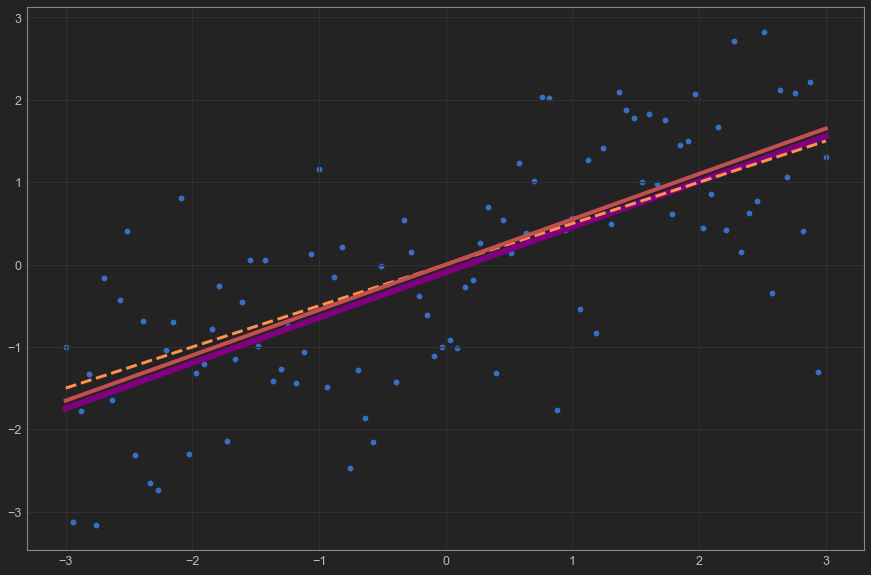

In [428]:
# Essential imports
import numpy as np
import statistics as st
import matplotlib.pyplot as plt
%matplotlib inline

# import jtplot submodule from jupyterthemes to style our plots
from jupyterthemes import jtplot
jtplot.style()

# Import learning tools
from sklearn.linear_model import  LinearRegression
from sklearn.metrics import mean_squared_error, r2_score


# probability density function of a gaussian random variable
# note that this is a normal distrubution, so (mean = median = mode)
p_g = lambda x, mean, variance : 1/np.sqrt(2*np.pi*variance)*np.exp(-((x-mean)**2)/(2*variance))


# hand code a quadratic function using the Gaussian Probability function
# so we can compare to our regression/interpolation
linear_model = lambda x : (0.5)*x + p_g(x, 10, 2)

# function that generates a set of points that are a random, constrained distance
# from our ideal quadratic curve
data_gen = lambda x : (0.5)*x + np.random.normal(0,1)

# generate our input points in the x-dimension
x = np.linspace(-3,3,100)

# generate our synthetic dataset (aka the y-values of scatterplot points)
data___ = [data_gen(i) for i in x]

# prepare synthetic dataset graph for regression
#x = np.linspace(-3,3,100)
x = x[:, np.newaxis]

y = np.asarray(data___)
y = y[:, np.newaxis]

# linear fit
model = LinearRegression()
model.fit(x, y)
y_pred = model.predict(x)

# ideal polynomial fit
y_ideal = linear_model(x)


# plot it
plt.figure(figsize=(15,10))

    # raw synthetic dataset
plt.scatter(x, y)
    # linear fit
plt.plot(x, y_pred, color='purple', linewidth=6)
    # hand-coded quadratic function
plt.plot(x, y_ideal, '--', linewidth=3, color='y')


    # hand-coded gradient desent
batch_grad_descent = lambda m, X, y, theta: (2/m) * (X.T.dot(X.dot(theta) - y))

g = 0.1 # gamma, learning rate
n_iterations = 1050
m = len(y)
theta = 1

for iteration in range(n_iterations):
    gradients = batch_grad_descent(m, x, y, theta)
    theta -= g * gradients
    if iteration >= n_iterations-20: print(gradients)
plt.plot(x, theta*x, '-', c='r', linewidth=4,)




# calculate gradient descent
print("Metrics of gradient descent:")
rmse = np.sqrt(mean_squared_error(y,y_pred))
r2 = r2_score(y,theta*x)
print("  RMSE: ", rmse)
print("  R2: ", r2)
print("-------------------------------------")

# calculate regression metrics
print("Metrics of regression:")
rmse = np.sqrt(mean_squared_error(y,y_pred))
r2 = r2_score(y,y_pred)
print("  RMSE: ", rmse)
print("  R2: ", r2)
print("-------------------------------------")

# calculate ideal metrics
print("Metrics of ideal equation:")
rmse = np.sqrt(mean_squared_error(y,y_ideal))
r2 = r2_score(y,y_ideal)
print("  RMSE: ", rmse)
print("  R2: ", r2)


## Gradient Descent _ next

In [30]:
# symbolic math with python
from sympy import *

# tell SymPy to start printing output with LaTeX
init_printing() 

# jit compiling
from numba import jit

# numpy
import numpy as np

In [31]:
theta = symbols('theta') # symbolic vector
n = 'n' # represents current instance [1..n] instances
m = 'm' # represents current feature [1..m] features
m = 3   # number of features, plus one: range(5) = [0,1,2,3,4]

t = []  # parameters
x = []  # feature values
#y = []  # observed values / "targets"
#y.append(symbols('y_{}'.format(n)))
y = symbols('y_{}'.format(n))

for i in list(range(m)):
    t.append(symbols('theta_{}'.format(str(i))))
    x.append(symbols('x_{}{}'.format(str(i), n)))
x[0] = 1
display(Eq(y, sum([t[i]*x[i] for i in range(len(t))])))

errF = sum([t[i]*x[i] for i in range(len(t))]) - y
display(Eq(Function('E')(theta), errF))

errF_ = lambdify([i for i in t]+[i for i in x][1:]+[y], errF, 'numpy')
display(errF_)

<function _lambdifygenerated(theta_0, theta_1, theta_2, x_1n, x_2n, y_n)>

In [81]:
init_printing(pretty_print=False)

In [77]:
%matplotlib notebook
import numpy as np
import ipympl
import ipywidgets as widgets
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

In [61]:
data_gen = lambda x : (0.67)*x + np.random.normal(0,1.766)

x = np.linspace(-3,3,100)
y = np.asarray([data_gen(i) for i in x])

[0.6819374670124185] [3.180625329875815]
[0.5585677572475385] [1.2336970976488004]
[0.5107152637629789] [0.4785249348455951]
[0.4921542965932104] [0.18560967169768527]
[0.48495489114554263] [0.07199405447667782]
[0.4821623944870533] [0.02792496658489334]
[0.4810792442680029] [0.01083150219050392]
[0.480659113273947] [0.004201309940559171]
[0.48049615337322227] [0.0016295990072472933]
[0.4804329446844563] [0.0006320868876595399]
[0.4804084273748744] [0.00024517309581931104]
[0.48039891763055165] [9.509744322709679e-05]
[0.48039522900245074] [3.688628100910307e-05]
[0.480393798261854] [1.4307405967208808e-05]
[0.4803932433079256] [5.5495392842175305e-06]
[0.4803930280530685] [2.152548570997226e-06]
[0.4803929445602755] [8.349279302422019e-07]
[0.4803929121751921] [3.2385083386543557e-07]
[0.4803928996137052] [1.2561486890660943e-07]
[0.48039289474137087] [4.872334290695335e-08]
[0.4803928928514958] [1.889875107963235e-08]
[0.4803928921184533] [7.3304246583916214e-09]
[0.4803928918341217]

<IPython.core.display.Javascript object>


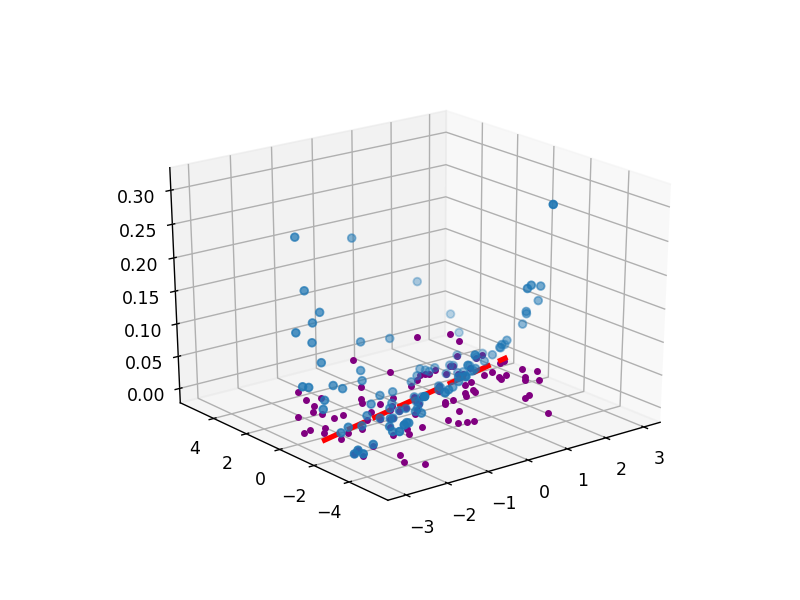

In [97]:
MSE = lambda m, x, y, t: (1/m)*(t*x - y)**2
dMSE = lambda m, x, y, t: (2/m) * x.T.dot(x.dot(t) - y)

# initial-theta, gamma (learning rate), # iterations, size of dataset
t, gamma, niters, m = 1, 0.1, 25, len(x)

z = MSE(m,x,y,t)        # plot mean-squared-error
z_proj = dMSE(m,x,y,t)  # plot derivative of MSE with respect to theta

ts = [t] # keep track of changes in theta so we can plot it

for i in range(niters):
    dmse = dMSE(m, x, y, t)
    t -= gamma*dmse
    ts.append(t)
    print([t], [dmse])
    
fig = plt.figure()
ax1 = fig.add_subplot(111, projection='3d')
plt.plot(x, y, '.', c='purple', linewidth=1)
plt.plot(x, t*x, '--', c='r', linewidth=3)
ax1.scatter(x, y, z)
#ax1.scatter(x, y, z_proj)

<IPython.core.display.Javascript object>


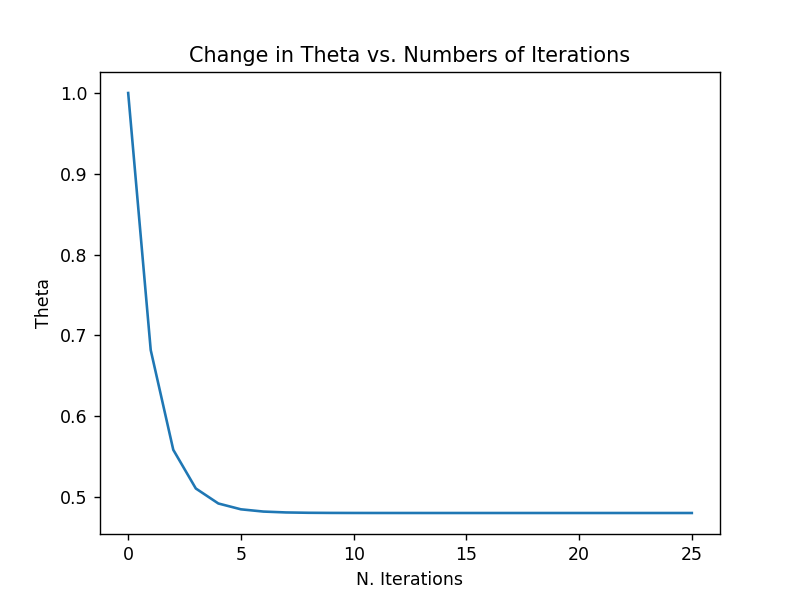

In [94]:
fig = plt.figure()
plt.title('Change in Theta vs. Numbers of Iterations')
plt.xlabel('N. Iterations')
plt.ylabel('Theta')
plt.plot(list(range(niters+1)), ts)

In [241]:
def my_grad_descent(# function representing the surface we're descending
                            F_,
                    # current (starting) x-position:
                            curx = 1,    
                    # current (starting) y-position:
                            cury = 1,   
                    # delta-z, change in z-position, z = f(x,y):
                            dz = 1,   
                    # arclength resolution: (2pi radians / arcres):
                            arcres = 8,
                    # radius of search func / linear resolution:
                            linres = 2, 
                    # minimum linear search length:
                            min_linres = 0.0001, 
                    # scaling factor for learning
                    ## resolution scaling:
                            rate = 0.6,
                    # maximum number of iterations:
                            maxiter = 200, ):
    
    curz = F_(curx, cury) # starting z-position
    steps = [[curx,cury,curz]] # track the steps taken by the algorithm
    best = [curx, cury, curz]

    # DEFINE SEARCH FUNCTION
    def find_best_direction(f, curx, cury, linres, arcres): # f is a math func that takes two inputs (x, y)
        
        def search_radius(curx, cury, linres, arcres):
            arcsecs = [(2*np.pi / arcres) * i for i in range(arcres)]
            radii = np.asarray([[curx + linres*np.cos(i), 
                                 cury + linres*np.sin(i)] 
                                for i in arcsecs])
            return radii
        
        radii = search_radius(curx, cury, linres, arcres)
        zs = [f(i[0], i[1]) for i in radii] # set of z-values, such that z_n = f(x_n, y_n)

        # return [x, y, z]  for (x,y) that give greatest change in z
        xy = radii[zs.index(min(zs))]
        return np.asarray([xy[0], xy[1], min(zs)])   
    
    # DO THE CALCULATIONS
    for i in range(maxiter):
        prevx, prevy = curx, cury
        prevz = curz

        best_dirs = np.asarray([find_best_direction(F_, curx, cury, linres*rate**i, 
                                                    arcres) 
                                for i in list(range(-10, 10))])

        # sort based on z values and choose the smallest z
        best_dir = best_dirs[[np.argsort(best_dirs[:,2])], :][0][0]

        curx, cury = best_dir[0], best_dir[1]
        curz = best_dir[2]

        xstep, ystep = abs(curx - prevx), abs(cury - prevy)
        dz = curz - prevz

        steps.append([curx, cury, curz])
        if curz < prevz: best = [curx, cury, curz]

    return np.asarray(steps), best

In [274]:
#F_ = lambda x, y: MSE(m,x,y,t)
F_ = lambda x, y: (1-x)**2 + 100*(y - x**2)**2
#F_ = lambda x, y: x**2 + y**2
steps, best = my_grad_descent(F_ = F_, curx=0, cury=4, 
                              arcres=24, linres=0.1, 
                              rate=0.1, maxiter=155)

print((steps[-1], len(steps)))
print(best)

(array([1.02373671e+00, 1.04952334e+00, 7.84395807e-04]), 156)
[1.0237367090657647, 1.0495233367907313, 0.0007843958071524126]


In [275]:
# Plotly plotting API
import plotly.offline as py
import plotly.graph_objs as go

# tell Plotly to display in our notebook
from plotly.offline import init_notebook_mode
init_notebook_mode()

# generate discrete grid of points on x and y axes
x = np.arange(-3.5, 8, 0.1)
y = np.arange(-0, 12, 0.1)

# mesh the axes (create x-y plane)
x, y = np.meshgrid(x, y)

# generate the z-coordinates for each discrete point in the xy plane
# for our surfaces
z = F_(x, y)      # surface 1: convex polynomial surface
z_ = F_(x, y)    # surface 2: derivative of surface 1, it's a plane

# make sure the graph is proportional when it renders
layout = go.Layout(
    scene=dict(
        aspectratio=dict(x=1, y=1, z=1)
    )
)

# define the plotly object for our surfaces
surface = go.Surface(x=x, y=y, z=z, colorscale='Viridis', opacity=0.9)
#surface_ = go.Surface(x=x, y=y, z=z_, colorscale='Cividis', opacity=1)

# plot the path of the descent
points = go.Scatter3d(x=steps[:,0],
                      y=steps[:,1],
                      z=steps[:,2], 
                      #mode = 'lines',
                      marker = dict(size = 4,
                                    color = list(range(len(steps))),
                                    colorscale='Jet'),
                      hoverinfo='z'
                      )

# plot the starting point, for reference
points_ = go.Scatter3d(x=[steps[-1,0]], y=[steps[-1,1]], z=[steps[-1,2]], marker=dict(size=6))

#plot it!
data = [surface, points, points_]
fig = go.Figure(data=data, layout=layout)
py.iplot(fig)

<IPython.core.display.Javascript object>


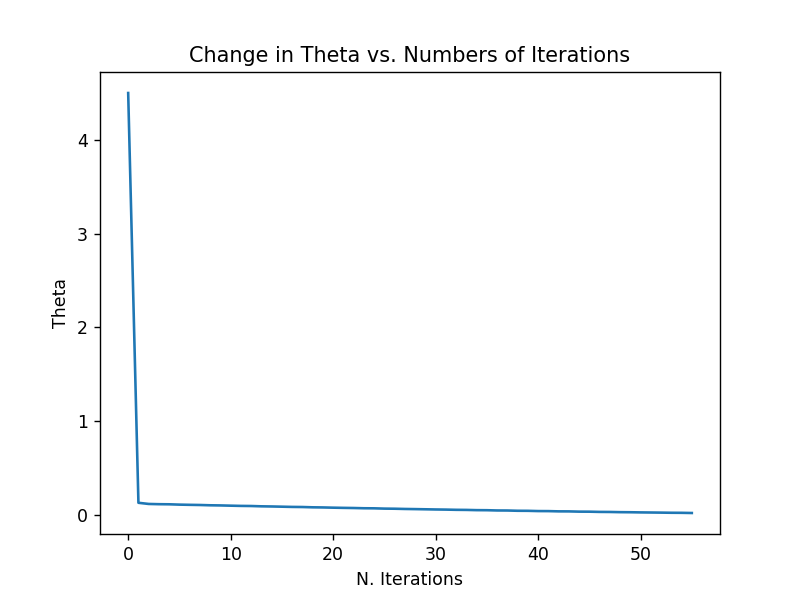

In [271]:
fig = plt.figure()
plt.title('Change in Theta vs. Numbers of Iterations')
plt.xlabel('N. Iterations')
plt.ylabel('Theta')
plt.plot([i for i in list(range(len(steps[:,2])))], steps[:,2])